In [1]:
%pylab inline
import wradlib as wrl     # wradlib = weather radar library (wradlib.org)
import numpy as np
import os
import pylab as plt
import datetime as dt
from glob import glob
import pyart              # another radar library
import imageio

from IPython.display import Image, display

Populating the interactive namespace from numpy and matplotlib

## You are using the Python ARM Radar Toolkit (Py-ART), an open source
## library for working with weather radar data. Py-ART is partly
## supported by the U.S. Department of Energy as part of the Atmospheric
## Radiation Measurement (ARM) Climate Research Facility, an Office of
## Science user facility.
##
## If you use this software to prepare a publication, please cite:
##
##     JJ Helmus and SM Collis, JORS 2016, doi: 10.5334/jors.119



C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\pyart\graph\cm.py:104: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if 'red' in spec:
C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\pyart\graph\cm_colorblind.py:32: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if 'red' in spec:


### Set the data path and generate the list of filenames

Set the data path and list the files we want to process. The string `0010P1_06` means the 6th file with elevation angle 1.0. This can be replaced with other elevation angles, this is just for consistency.

In [3]:
data_path = './Aparri_April2017/25/'
fnamelist = glob(data_path+'*0010P1_06*')

Check if list of names are consistent.

In [4]:
fnamelist[:3]

['./Aparri_April2017/25\\aparri_N182141_E1213744_H0002_201704250005_Z_EL+0010P1_06_13.bin.polar',
 './Aparri_April2017/25\\aparri_N182141_E1213744_H0002_201704250020_Z_EL+0010P1_06_13.bin.polar',
 './Aparri_April2017/25\\aparri_N182141_E1213744_H0002_201704250035_Z_EL+0010P1_06_13.bin.polar']

# Define the function to read file
This function reads the Appari, Guiuan, and Virac radars (Japan-sourced radars, the proprietary software they were using was called JBirds).

In [6]:
def read_JBirds(filename):
    f = open(filename, 'rb')
    r = np.fromfile(f, dtype='B')
    f.close()

    # Raw Data Header
    #   ignore first 96 members
    raw_data_header = r[96:352]
    # Sweep Data
    data = np.reshape(r[352:],(360,352))

    # Sweep Header
    sweep_header = data[:,:32]
    sweep_data = data[:,32:] * 0.3125 # 0.3125dBZ per member value

    # collect attributes from header
    attrs = {}

    # location
    loc = raw_data_header[1]
    if loc == int('40',16):
        attrs['Location'] = 'Virac'
        attrs['sitecoords'] = (13.62, 124.33, 0)
        attrs['Latitude'] = 13.62
        attrs['Longitude'] = 124.33
    elif loc == int('41',16):
        attrs['Location'] = 'Aparri'
        attrs['sitecoords'] = (18.35, 121.64, 0)
        attrs['Latitude'] = 18.35
        attrs['Longitude'] = 121.64
    elif loc == int('42',16):
        attrs['Location'] = 'Guiuan'
    else:
        attrs['Location'] = 'other'
    # Data type
    dattype = raw_data_header[3]
    if dattype == int('75',16):
        attrs['Data Type'] = 'Doppler Velocity'
    elif dattype == int('76',16):
        attrs['Data Type'] = 'Spectrum Width'
    elif dattype == int('F1',16):
        attrs['Data Type'] = 'Reflectivity'
    else:
        attrs['Data Type'] = 'other'
    # Date Time
    datestr = ''.join([chr(f) for f in raw_data_header[8:24]])
    attrs['time'] = dt.datetime.strptime(datestr, '%Y.%m.%d.%H.%M')
    # Response Status
    if raw_data_header[29] == 0:
        attrs['Response Status'] = 'Normal'
    else:
        attrs['Response Status'] = 'Error'
    # Step no.
    attrs['Step number'] = raw_data_header[42]
    ## Elevation
    #attrs['Elevation'] = raw_data_header[44]*360./(2**16)
    # Z-Relation-B
    attrs['Z-Relation B'] = raw_data_header[52]/100.
    # Z-Relation-Beta
    attrs['Z-Relation Beta'] = raw_data_header[54]/100.

    # get attributes from filename
    elev = int(fname[::-1][18:22][::-1])
    if fname[::-1][16:18][::-1] == 'P1':
        attrs['Elevation'] = elev / 10.
    elif fname[::-1][16:18][::-1] == 'P2':
        attrs['Elevation'] = elev / 100.
    attrs['Sweep'] = int(fname[::-1][13:15][::-1])

    attrs['MissingData'] = 255 * 0.3125
    if int(attrs['Sweep']) < 4:
        attrs['r'] = np.linspace(625,200000,320)
    else:
        attrs['r'] = np.linspace(1375,441375,320)
    attrs['az'] = np.linspace(1,360,360)

    data = np.where(sweep_data==attrs['MissingData'], np.nan, sweep_data)
    
    return data, attrs

For other radars supplied by EEC which uses the EDGE software, use `wradlib.io.read_edge_netcdf` for reading files.

# Read and plot a single file

In [7]:
fname = fnamelist[0]

Read the file.

In [8]:
data, attrs = read_JBirds(fname)

Explore the data attributes.

In [9]:
attrs

{'Location': 'Aparri',
 'sitecoords': (18.35, 121.64, 0),
 'Latitude': 18.35,
 'Longitude': 121.64,
 'Data Type': 'Reflectivity',
 'time': datetime.datetime(2017, 4, 25, 0, 5),
 'Response Status': 'Error',
 'Step number': 0,
 'Z-Relation B': 0.78,
 'Z-Relation Beta': 0.0,
 'Elevation': 1.0,
 'Sweep': 6,
 'MissingData': 79.6875,
 'r': array([  1375.        ,   2754.31034483,   4133.62068966,   5512.93103448,
          6892.24137931,   8271.55172414,   9650.86206897,  11030.17241379,
         12409.48275862,  13788.79310345,  15168.10344828,  16547.4137931 ,
         17926.72413793,  19306.03448276,  20685.34482759,  22064.65517241,
         23443.96551724,  24823.27586207,  26202.5862069 ,  27581.89655172,
         28961.20689655,  30340.51724138,  31719.82758621,  33099.13793103,
         34478.44827586,  35857.75862069,  37237.06896552,  38616.37931034,
         39995.68965517,  41375.        ,  42754.31034483,  44133.62068966,
         45512.93103448,  46892.24137931,  48271.55172414

# Plot the data

<Figure size 504x504 with 0 Axes>

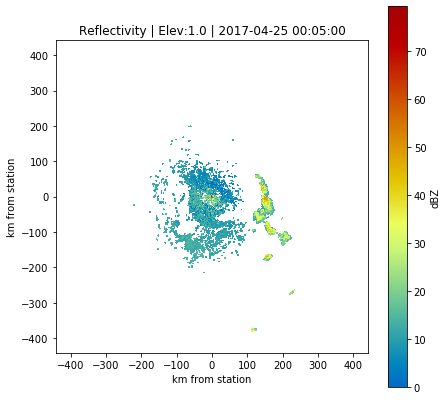

In [10]:
fig = plt.figure(figsize(7,7))
pm, ax = wrl.vis.plot_ppi(np.ma.masked_invalid(data),r=attrs['r']/1000.,az=attrs['az'], cmap=pyart.graph.cm_colorblind.HomeyerRainbow)
plt.xlabel('km from station')
plt.ylabel('km from station')
plt.title(attrs['Data Type']+' | Elev:'+str(attrs['Elevation'])+' | '+str(attrs['time']))
cb = plt.colorbar(ax)
cb.set_label('dBZ')

# Plot all the files in the list and save the figure

C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\wradlib\vis.py:245: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = pl.figure()
C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyp

C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\wradlib\vis.py:245: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = pl.figure()
C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyp

C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\wradlib\vis.py:245: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = pl.figure()
C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyp

C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\wradlib\vis.py:245: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = pl.figure()
C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyp

C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\wradlib\vis.py:245: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = pl.figure()
C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyp

C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\wradlib\vis.py:245: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = pl.figure()
C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyp

C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\wradlib\vis.py:245: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = pl.figure()
C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyp

C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.
C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\wradlib\vis.py:245: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = pl.figure()
C:\Users\iac6311\AppData\Local\Continuum\anaconda3\envs\wradlib\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyp

<Figure size 504x504 with 0 Axes>

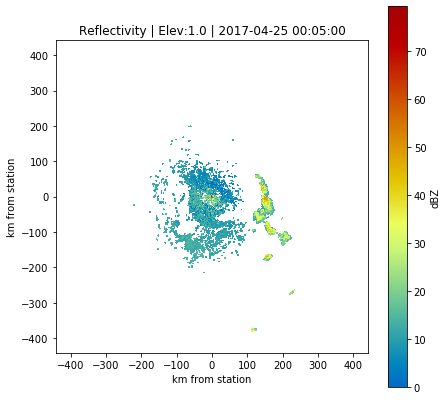

<Figure size 504x504 with 0 Axes>

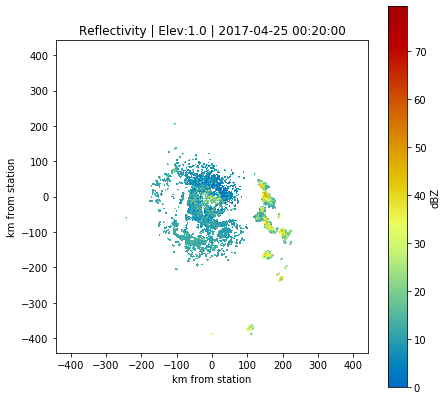

<Figure size 504x504 with 0 Axes>

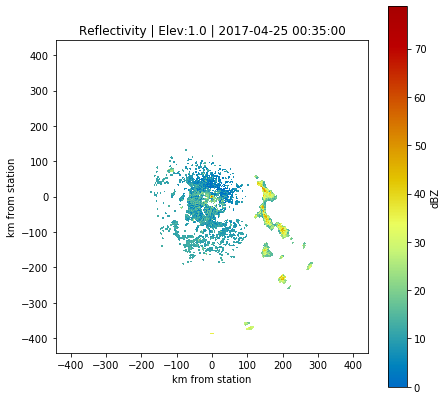

<Figure size 504x504 with 0 Axes>

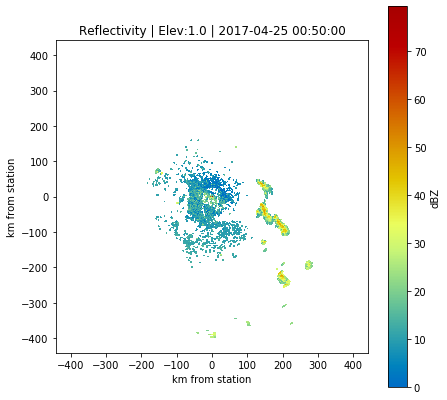

<Figure size 504x504 with 0 Axes>

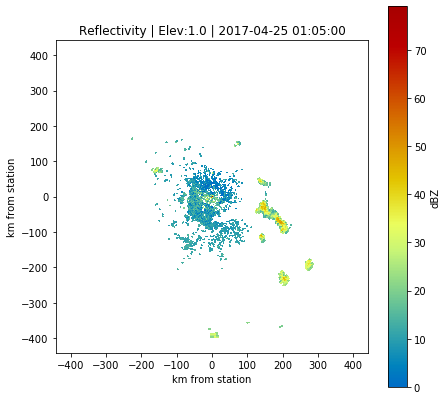

<Figure size 504x504 with 0 Axes>

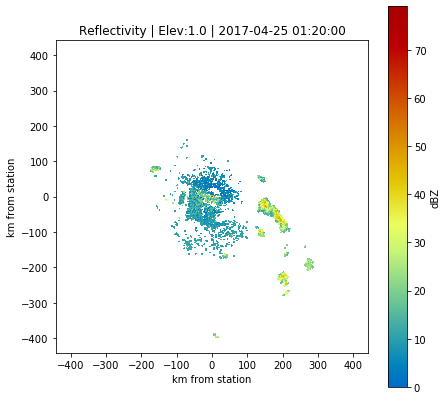

<Figure size 504x504 with 0 Axes>

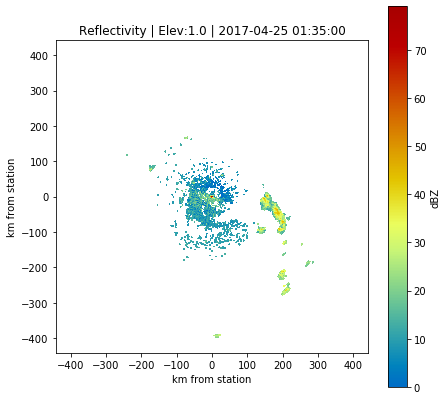

<Figure size 504x504 with 0 Axes>

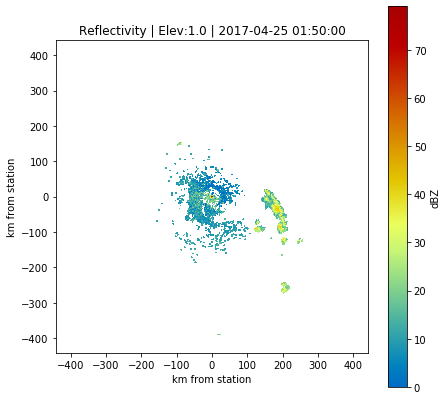

<Figure size 504x504 with 0 Axes>

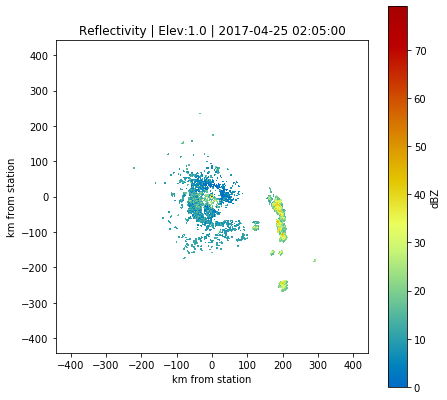

<Figure size 504x504 with 0 Axes>

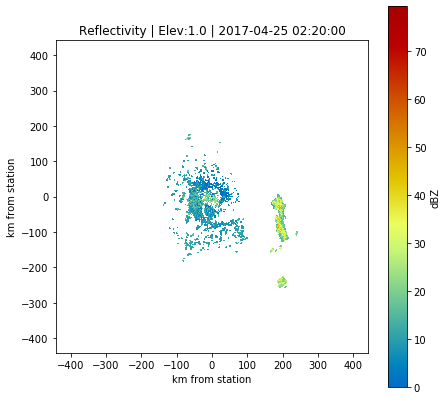

<Figure size 504x504 with 0 Axes>

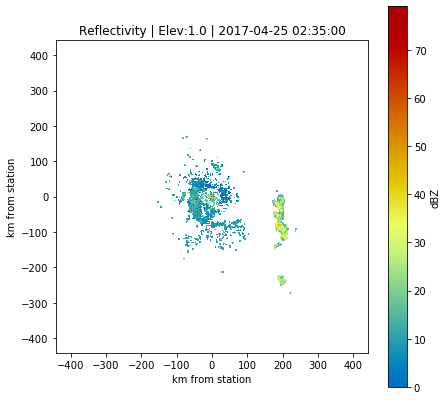

<Figure size 504x504 with 0 Axes>

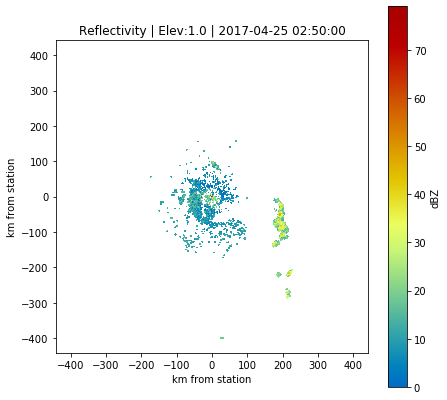

<Figure size 504x504 with 0 Axes>

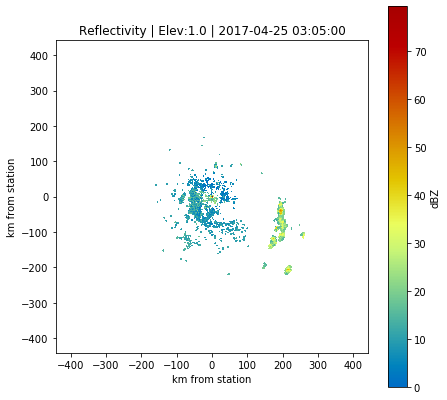

<Figure size 504x504 with 0 Axes>

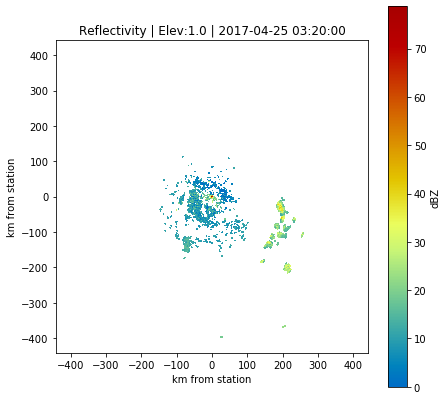

<Figure size 504x504 with 0 Axes>

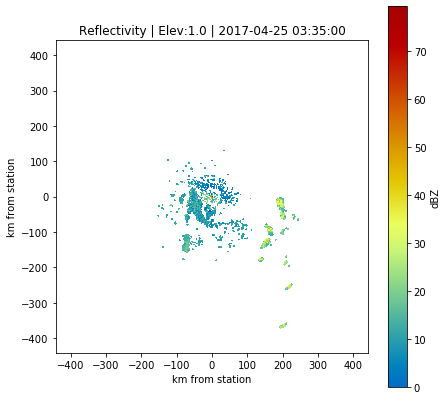

<Figure size 504x504 with 0 Axes>

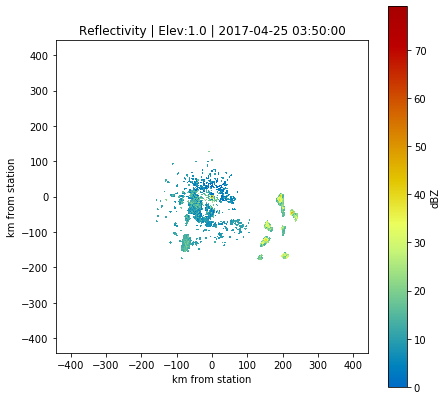

<Figure size 504x504 with 0 Axes>

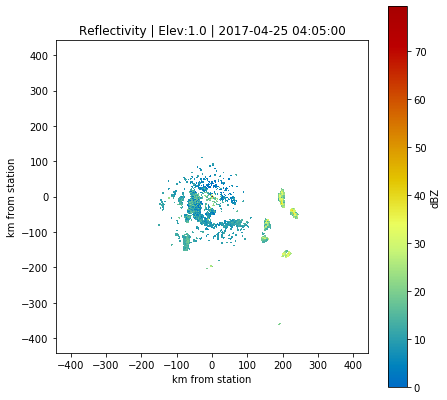

<Figure size 504x504 with 0 Axes>

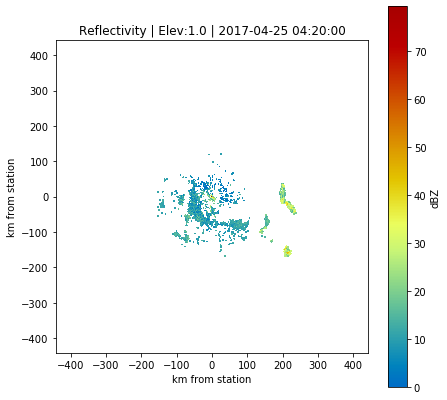

<Figure size 504x504 with 0 Axes>

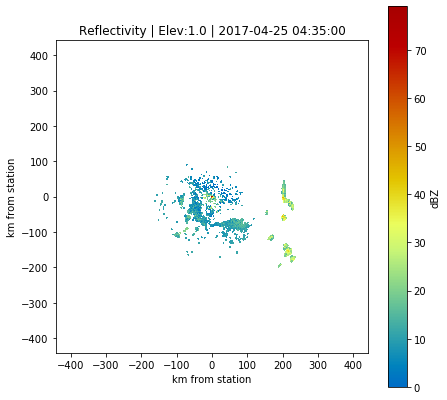

<Figure size 504x504 with 0 Axes>

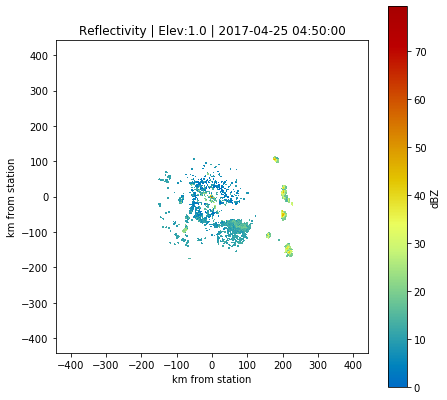

<Figure size 504x504 with 0 Axes>

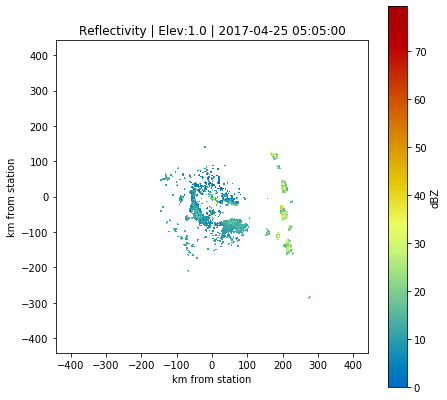

<Figure size 504x504 with 0 Axes>

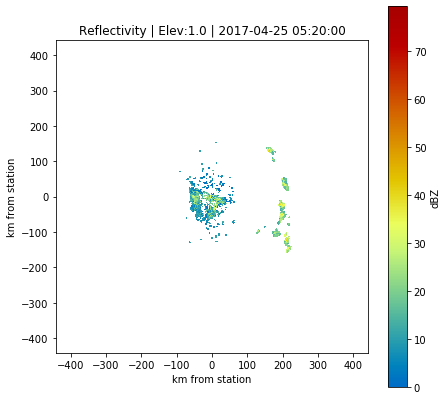

<Figure size 504x504 with 0 Axes>

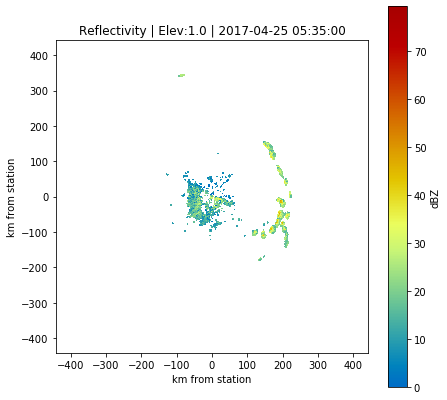

<Figure size 504x504 with 0 Axes>

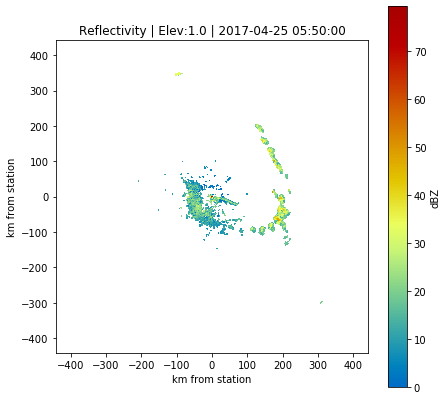

<Figure size 504x504 with 0 Axes>

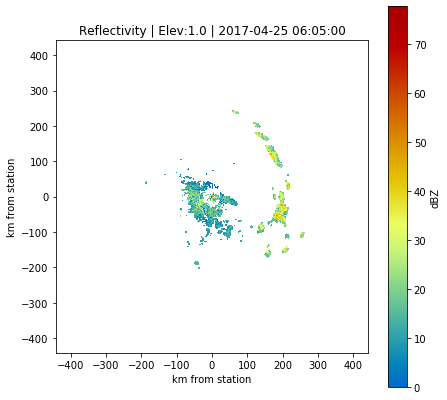

<Figure size 504x504 with 0 Axes>

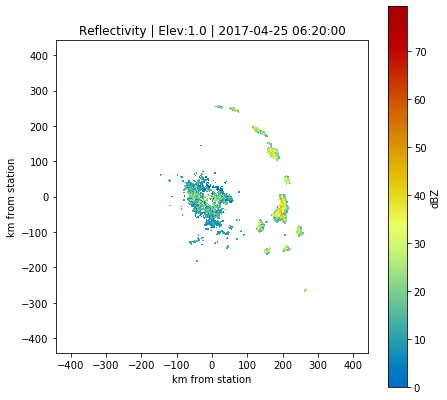

<Figure size 504x504 with 0 Axes>

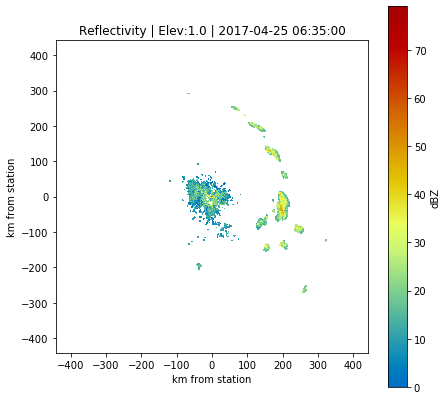

<Figure size 504x504 with 0 Axes>

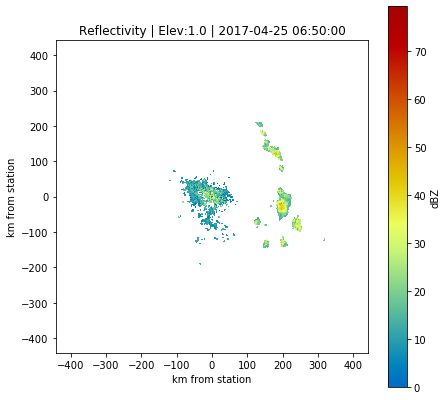

<Figure size 504x504 with 0 Axes>

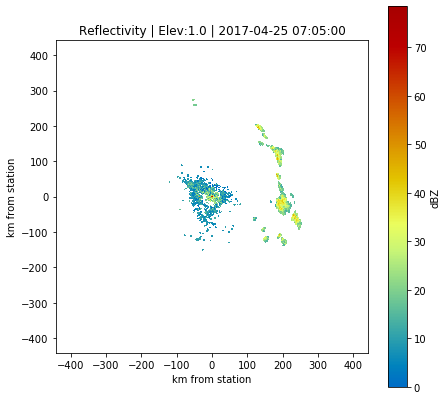

<Figure size 504x504 with 0 Axes>

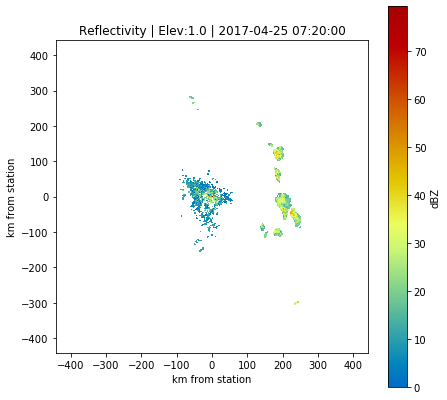

<Figure size 504x504 with 0 Axes>

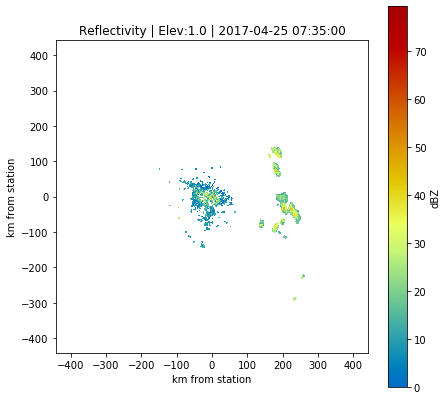

<Figure size 504x504 with 0 Axes>

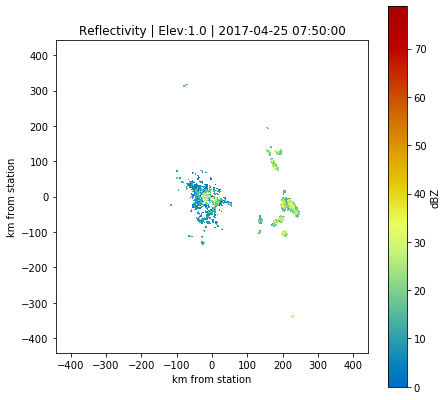

<Figure size 504x504 with 0 Axes>

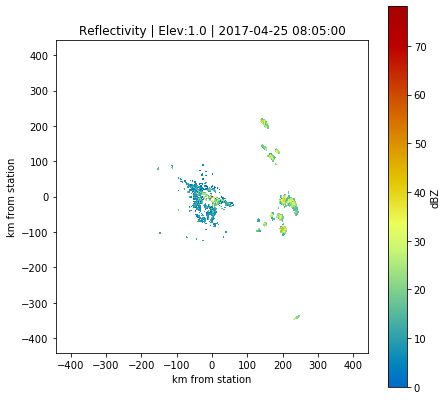

<Figure size 504x504 with 0 Axes>

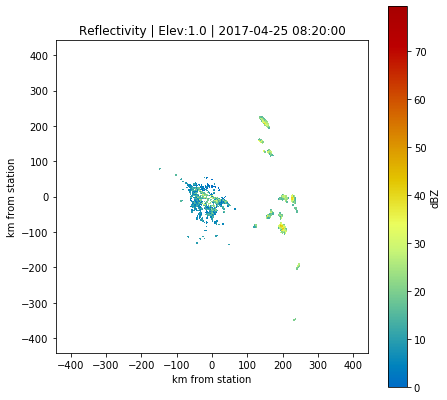

<Figure size 504x504 with 0 Axes>

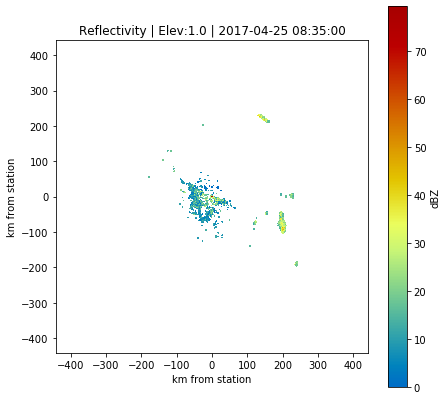

<Figure size 504x504 with 0 Axes>

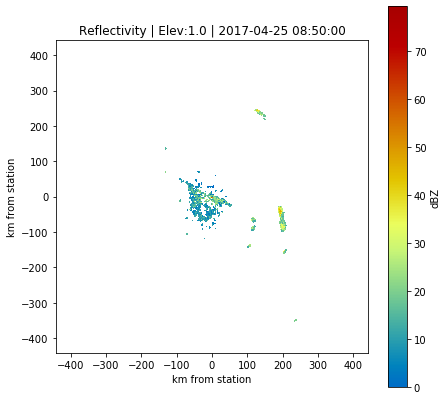

<Figure size 504x504 with 0 Axes>

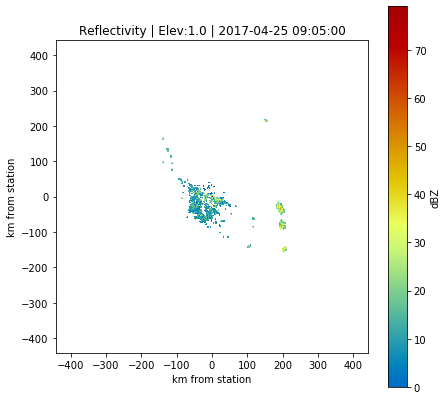

<Figure size 504x504 with 0 Axes>

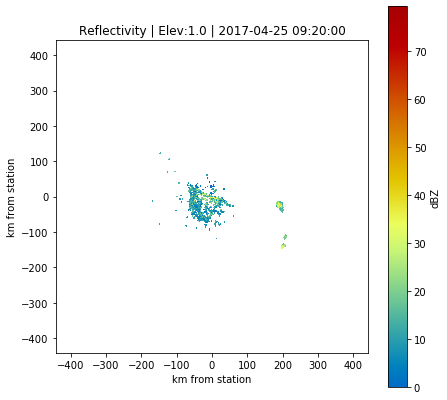

<Figure size 504x504 with 0 Axes>

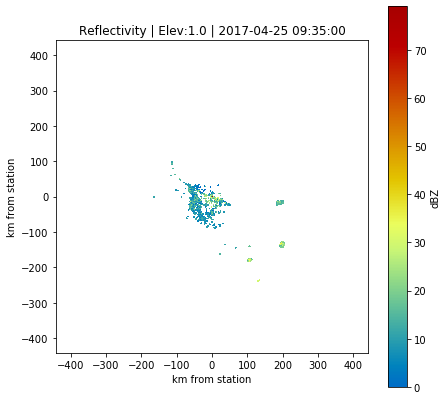

<Figure size 504x504 with 0 Axes>

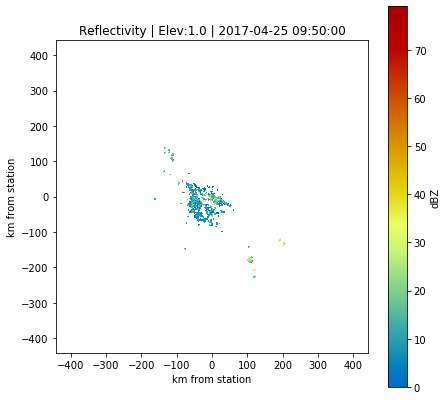

<Figure size 504x504 with 0 Axes>

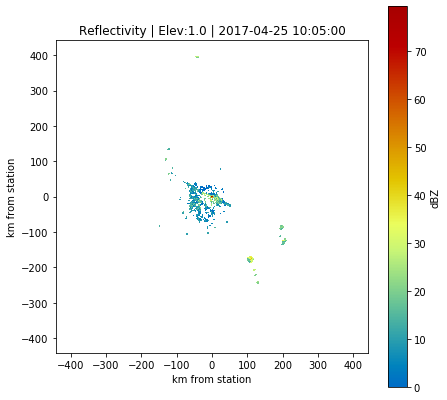

<Figure size 504x504 with 0 Axes>

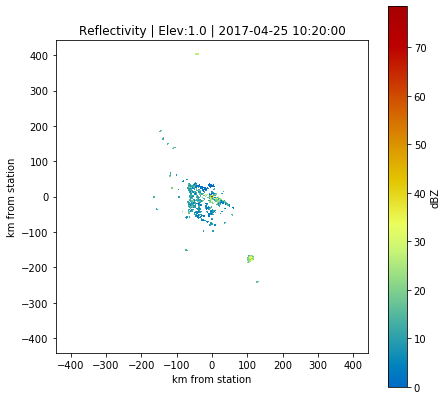

<Figure size 504x504 with 0 Axes>

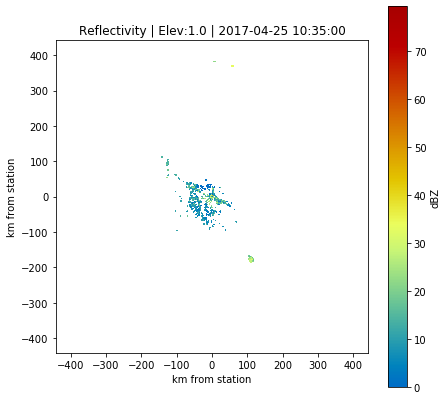

<Figure size 504x504 with 0 Axes>

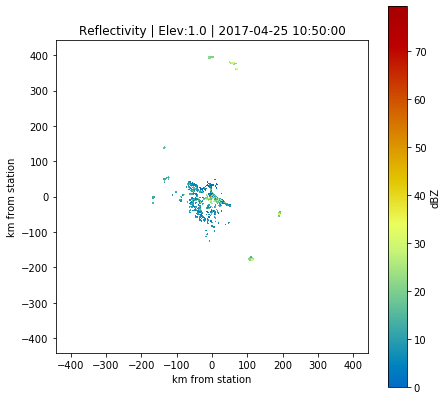

<Figure size 504x504 with 0 Axes>

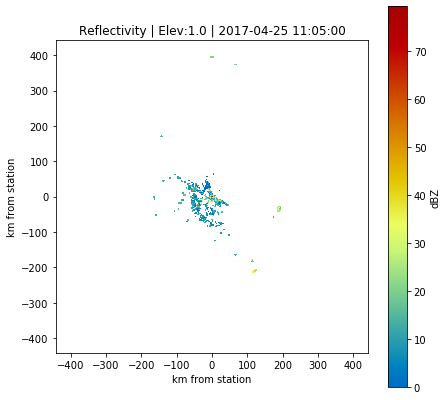

<Figure size 504x504 with 0 Axes>

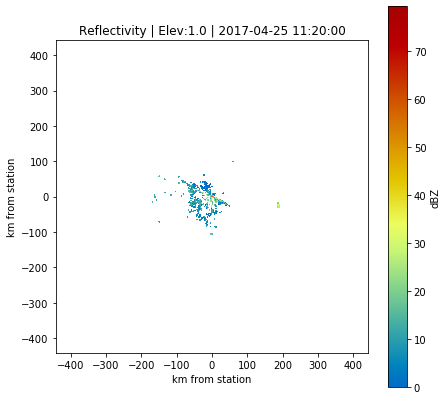

<Figure size 504x504 with 0 Axes>

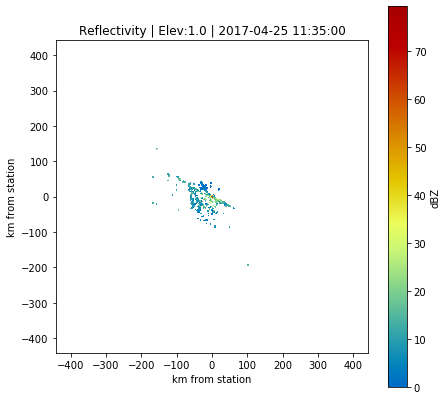

<Figure size 504x504 with 0 Axes>

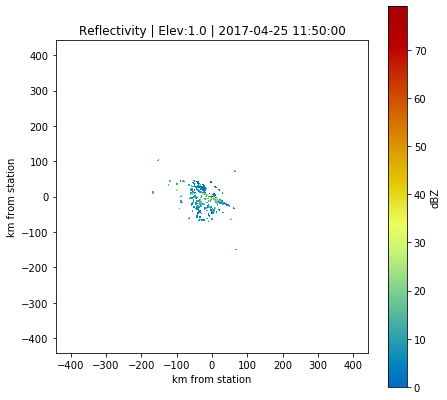

<Figure size 504x504 with 0 Axes>

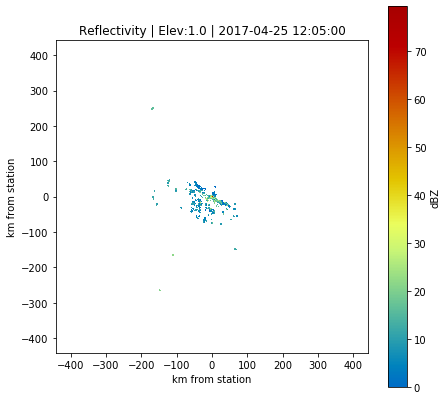

<Figure size 504x504 with 0 Axes>

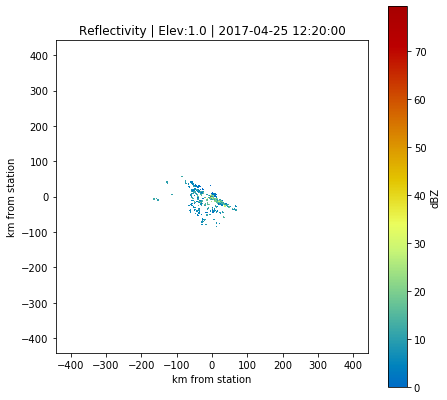

<Figure size 504x504 with 0 Axes>

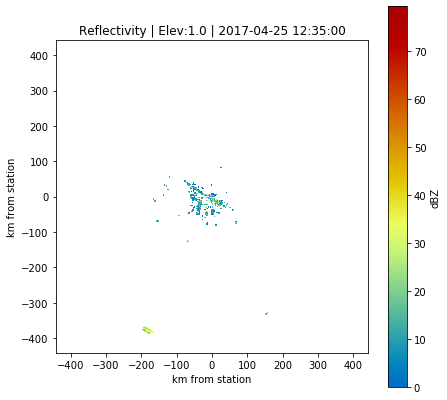

<Figure size 504x504 with 0 Axes>

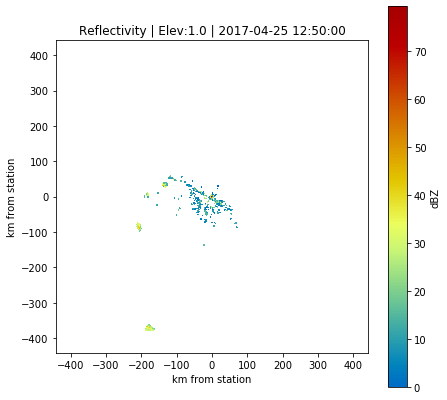

<Figure size 504x504 with 0 Axes>

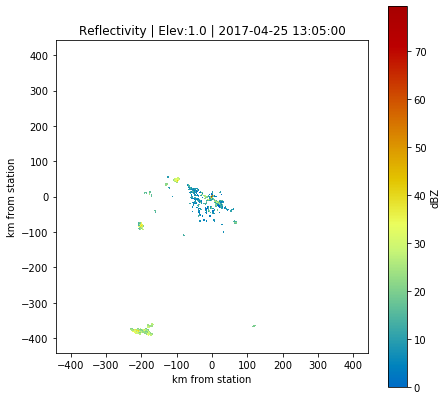

<Figure size 504x504 with 0 Axes>

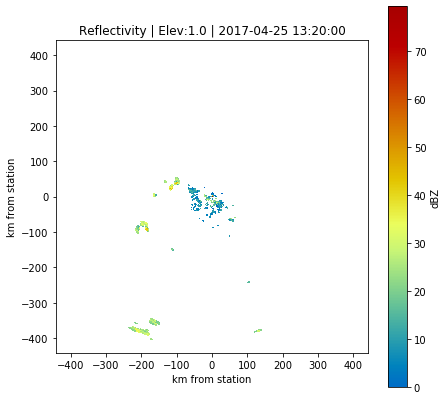

<Figure size 504x504 with 0 Axes>

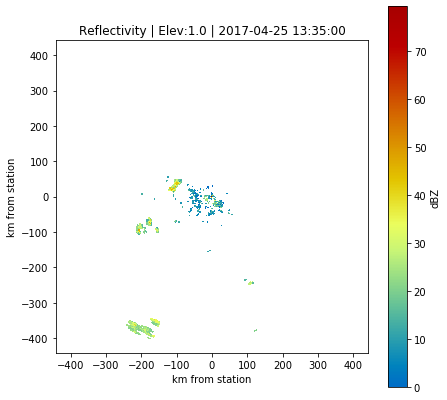

<Figure size 504x504 with 0 Axes>

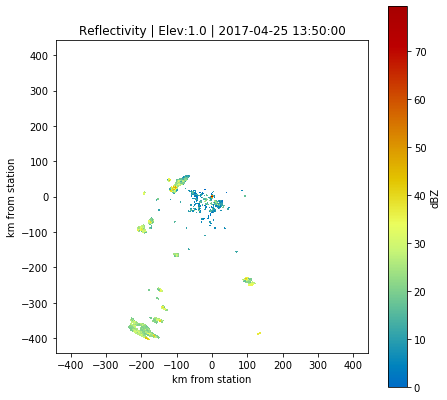

<Figure size 504x504 with 0 Axes>

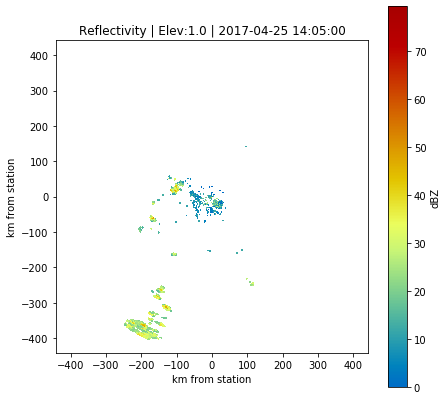

<Figure size 504x504 with 0 Axes>

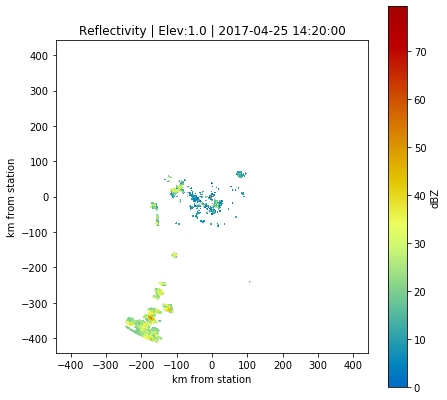

<Figure size 504x504 with 0 Axes>

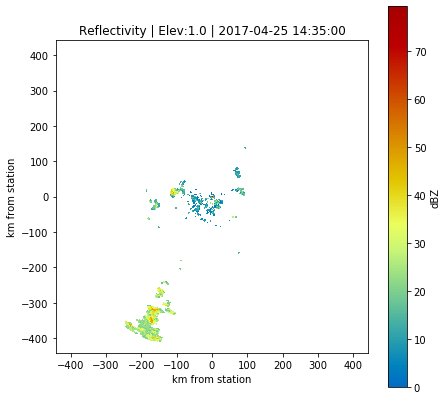

<Figure size 504x504 with 0 Axes>

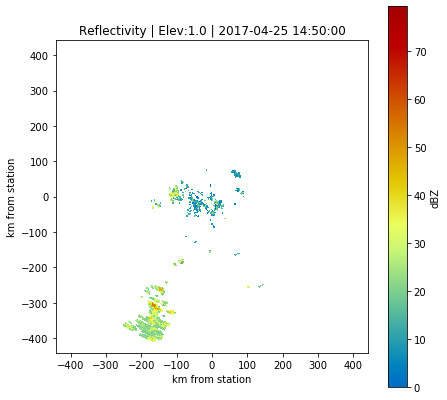

<Figure size 504x504 with 0 Axes>

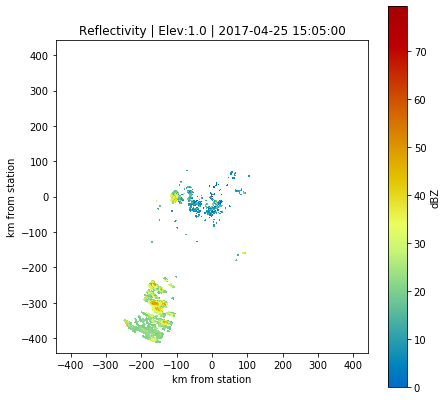

<Figure size 504x504 with 0 Axes>

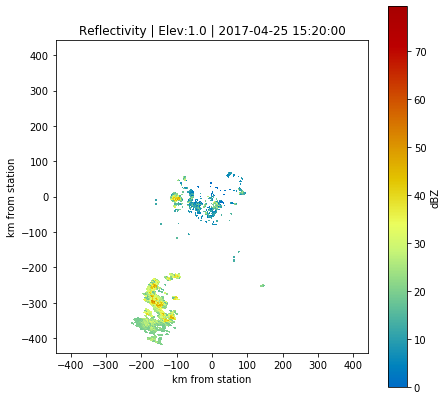

<Figure size 504x504 with 0 Axes>

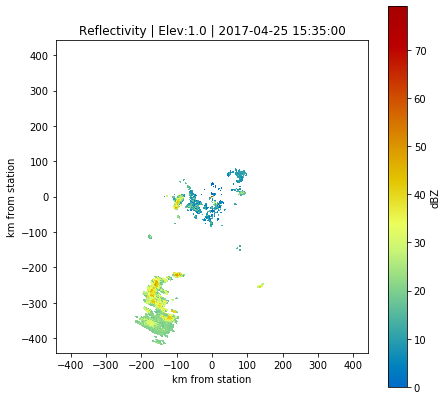

<Figure size 504x504 with 0 Axes>

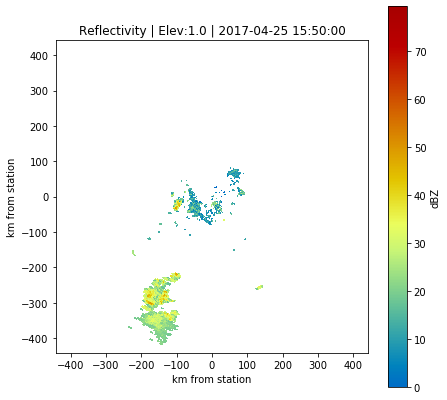

<Figure size 504x504 with 0 Axes>

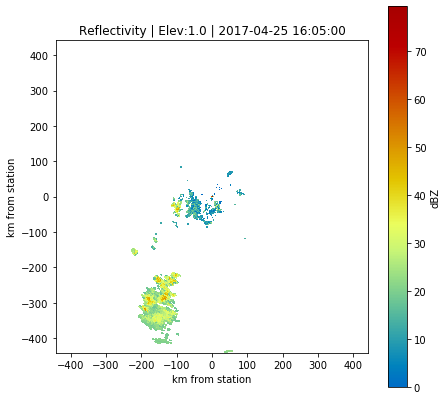

<Figure size 504x504 with 0 Axes>

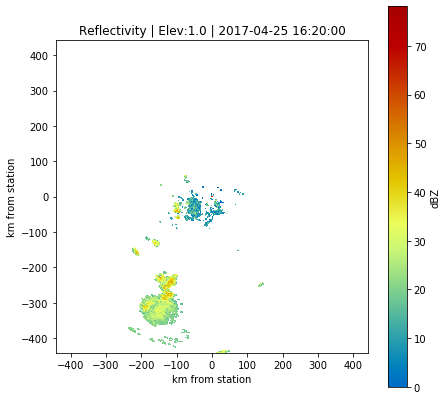

<Figure size 504x504 with 0 Axes>

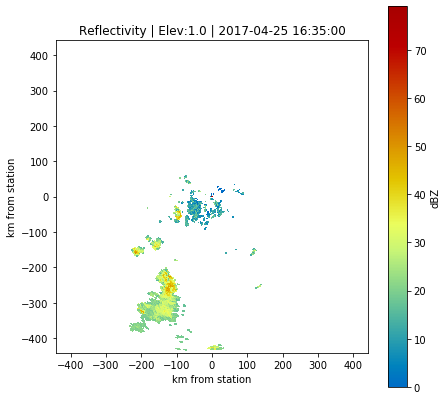

<Figure size 504x504 with 0 Axes>

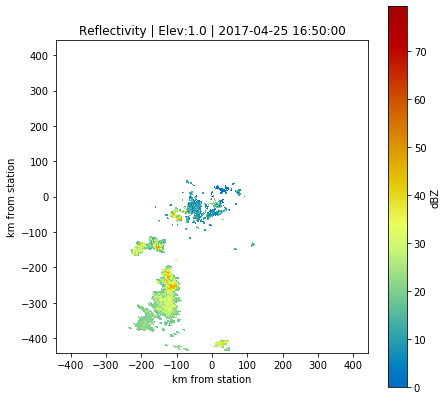

<Figure size 504x504 with 0 Axes>

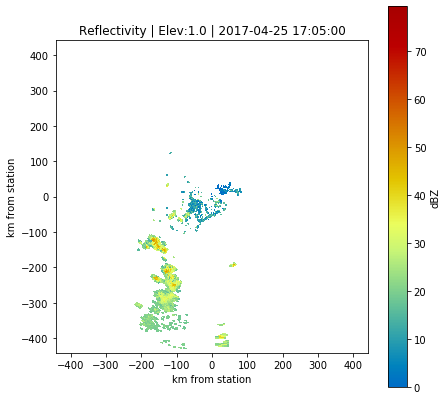

<Figure size 504x504 with 0 Axes>

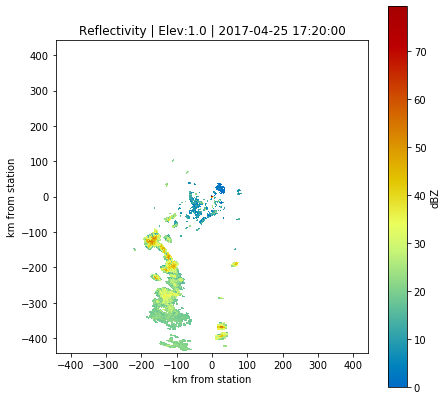

<Figure size 504x504 with 0 Axes>

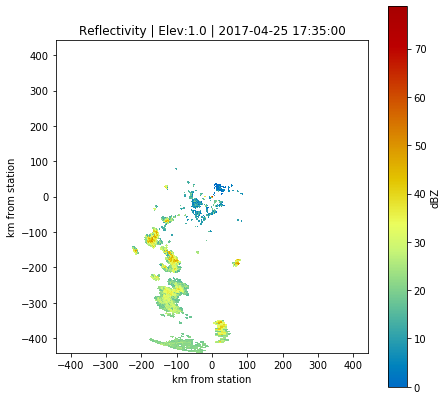

<Figure size 504x504 with 0 Axes>

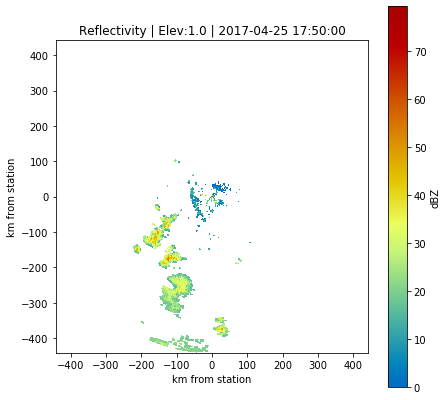

<Figure size 504x504 with 0 Axes>

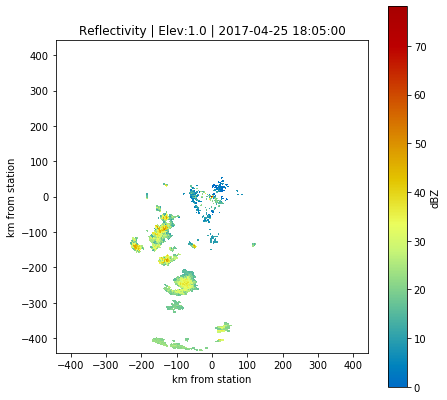

<Figure size 504x504 with 0 Axes>

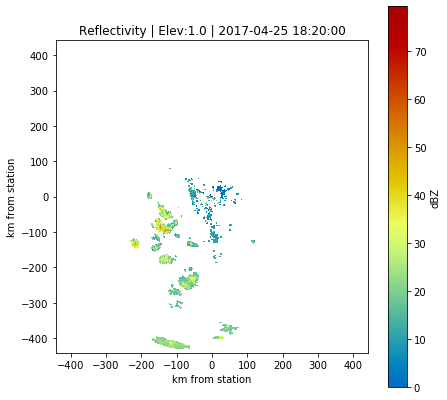

<Figure size 504x504 with 0 Axes>

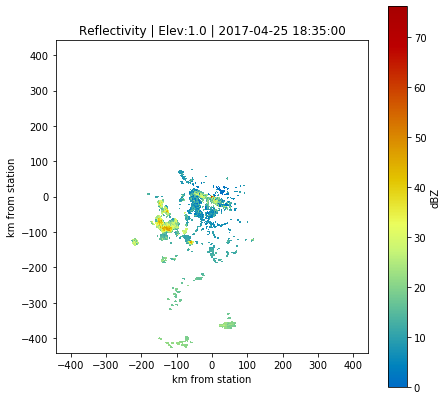

<Figure size 504x504 with 0 Axes>

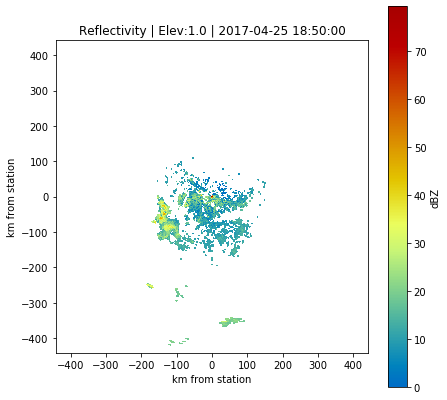

<Figure size 504x504 with 0 Axes>

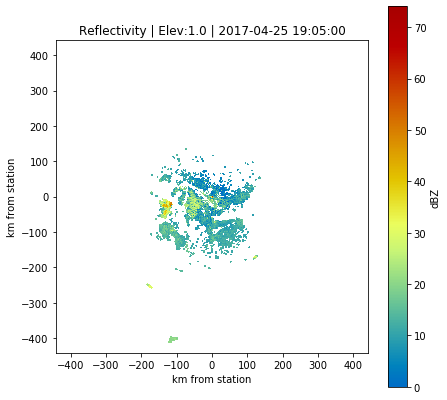

<Figure size 504x504 with 0 Axes>

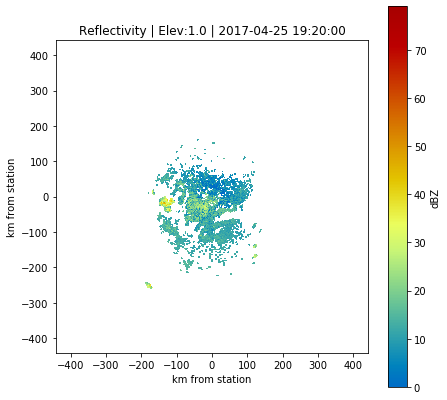

<Figure size 504x504 with 0 Axes>

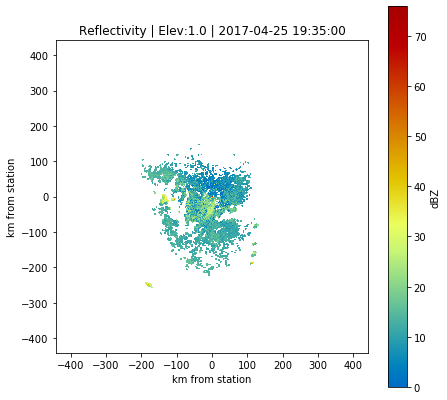

<Figure size 504x504 with 0 Axes>

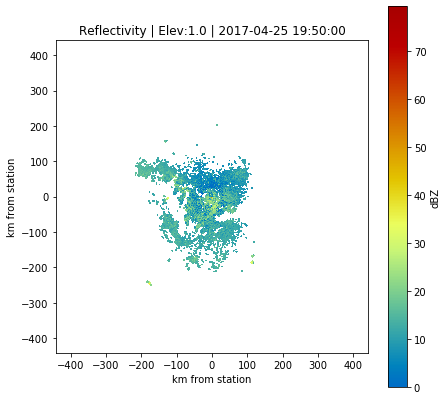

<Figure size 504x504 with 0 Axes>

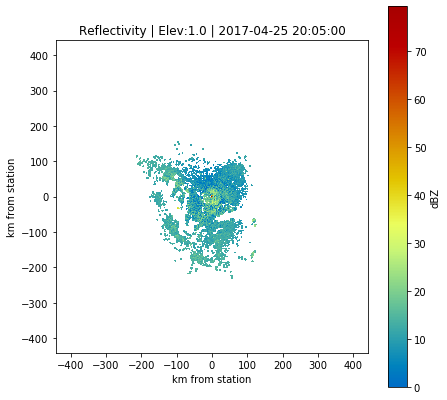

<Figure size 504x504 with 0 Axes>

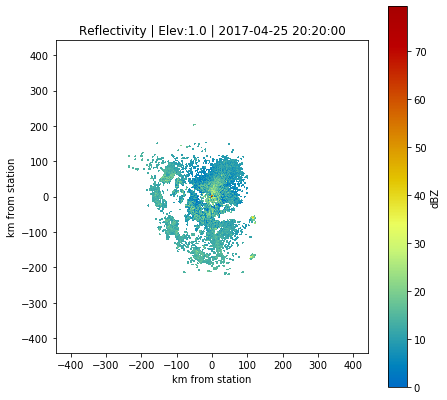

<Figure size 504x504 with 0 Axes>

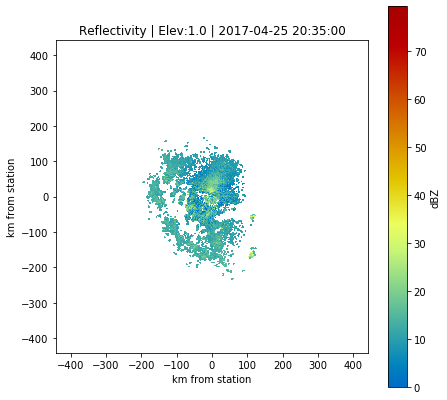

<Figure size 504x504 with 0 Axes>

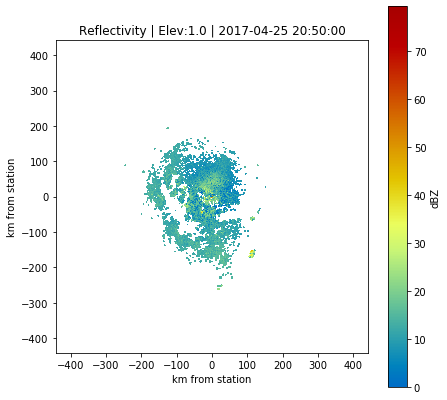

<Figure size 504x504 with 0 Axes>

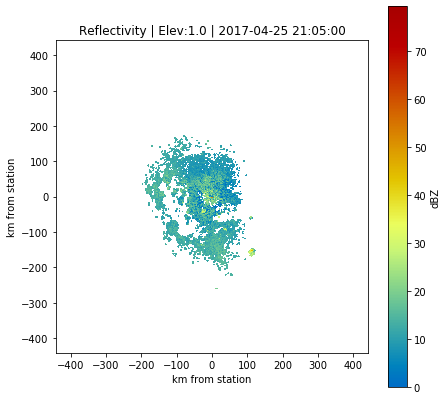

<Figure size 504x504 with 0 Axes>

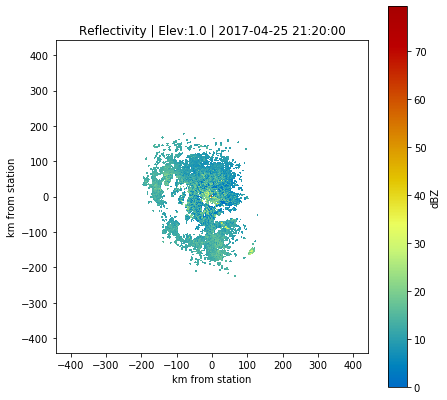

<Figure size 504x504 with 0 Axes>

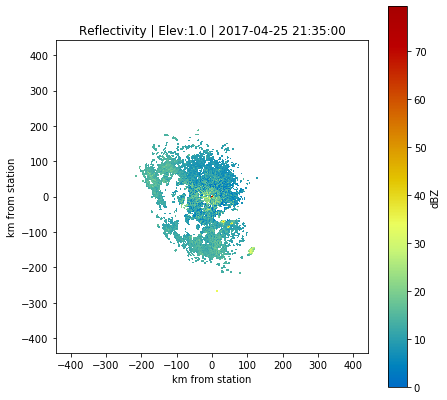

<Figure size 504x504 with 0 Axes>

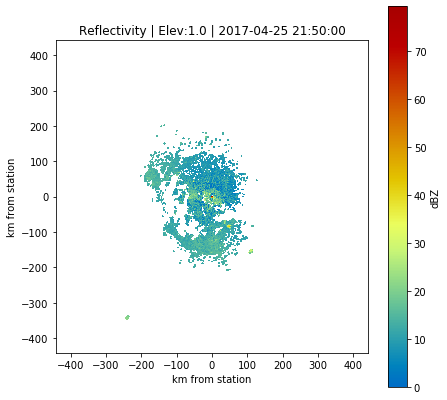

<Figure size 504x504 with 0 Axes>

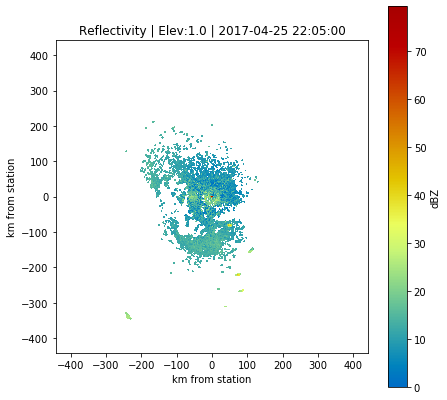

<Figure size 504x504 with 0 Axes>

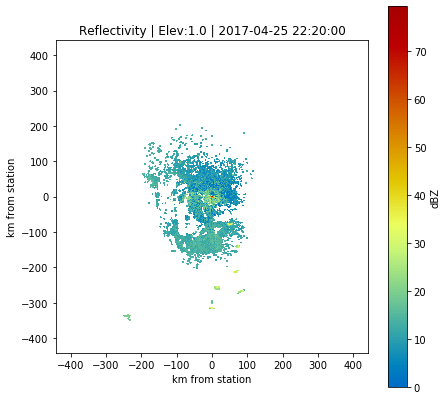

<Figure size 504x504 with 0 Axes>

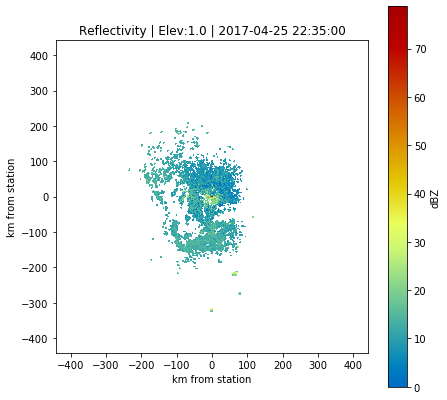

<Figure size 504x504 with 0 Axes>

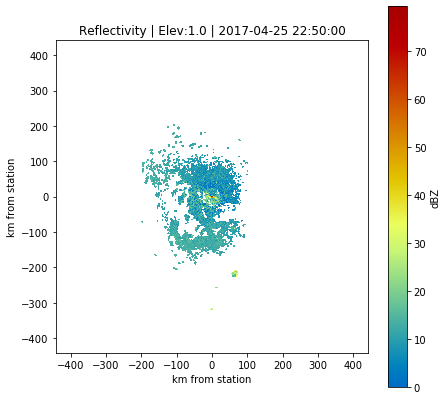

<Figure size 504x504 with 0 Axes>

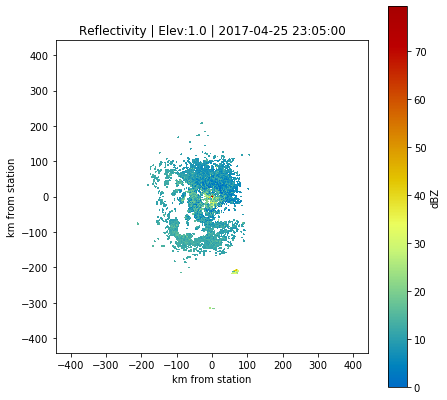

<Figure size 504x504 with 0 Axes>

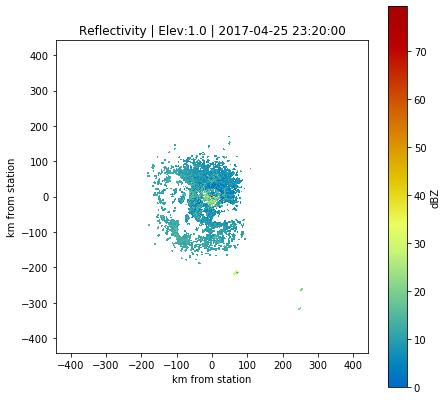

<Figure size 504x504 with 0 Axes>

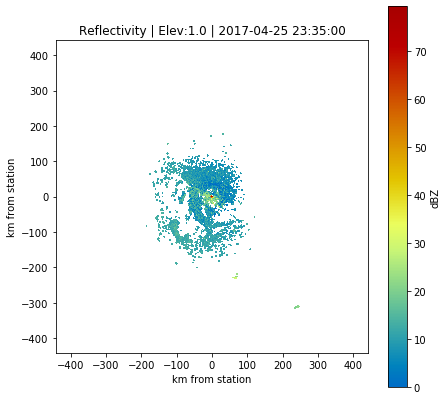

<Figure size 504x504 with 0 Axes>

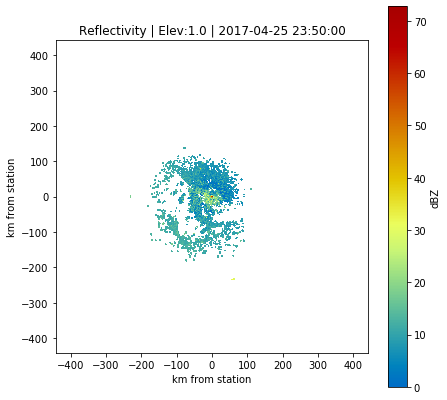

In [109]:
for fname in fnamelist:
    data, attrs = read_JBirds(fname)
    
    fig = plt.figure(figsize(7,7))
    pm, ax = wrl.vis.plot_ppi(np.ma.masked_invalid(data),r=attrs['r']/1000.,az=attrs['az'], cmap=pyart.graph.cm_colorblind.HomeyerRainbow)
    plt.xlabel('km from station')
    plt.ylabel('km from station')
    plt.title(attrs['Data Type']+' | Elev:'+str(attrs['Elevation'])+' | '+str(attrs['time']))
    cb = plt.colorbar(ax)
    cb.set_label('dBZ')
    
    savefname = dt.datetime.strftime(attrs['time'],'Aparri_%Y%m%d_%H%M%S.png')
    plt.savefig(os.path.join('./plots',savefname))

# Create an animation of the plots

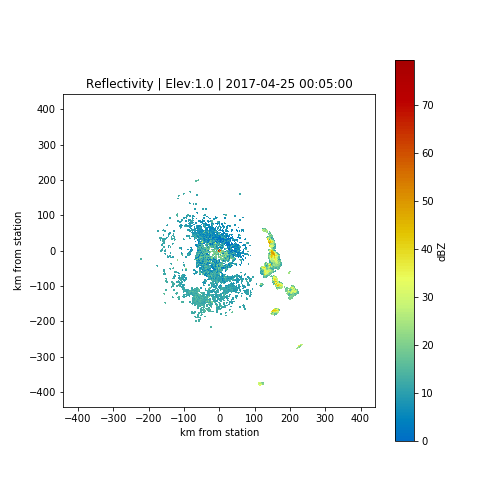

In [116]:
date = '20170425'
im_files = glob('./plots/*'+date+'*.png')
im_files.sort()
images = []
for filename in im_files:
    images.append(imageio.imread(filename))
imageio.mimsave('refl_animation_'+date+'.gif', images, duration=0.5)

with open('refl_animation_'+date+'.gif','rb') as f:
    display(Image(f.read()))

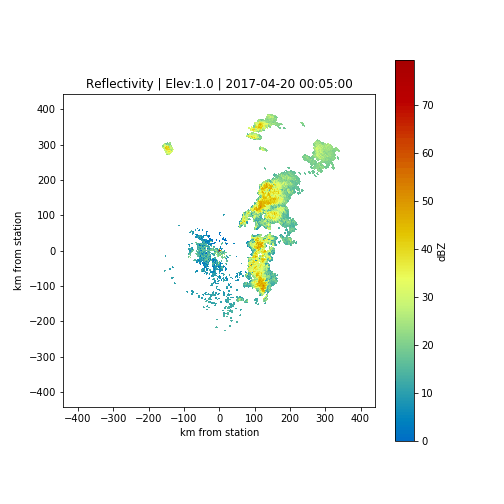

In [117]:
im_files = glob('./plots/*.png')
im_files.sort()
images = []
for filename in im_files:
    images.append(imageio.imread(filename))
imageio.mimsave('refl_animation_ALL.gif', images, duration=0.5)

with open('refl_animation_ALL.gif','rb') as f:
    display(Image(f.read()))